### Initialization

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
pip install drive/MyDrive/sdas-1.0.tar.gz

In [ ]:
pip install umap-learn

In [ ]:
!git clone https://github.com/josemiotto/pylevy.git
%cd pylevy
!python setup.py install
%cd ..

In [ ]:
pip install fastdtw

In [ ]:
from copy import copy, deepcopy
from fastdtw import fastdtw
from pylevy import *
from numpy import *
from scipy import interpolate
from scipy.optimize import curve_fit, minimize
from scipy.signal import coherence
from scipy.spatial.distance import euclidean
from scipy.stats import levy_stable, chisquare
from sdas.core.client.SDASClient import SDASClient
from sdas.core.SDAStime import Date, Time, TimeStamp
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from tensorflow.keras import Model
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Conv1D, Dense, Dropout, AveragePooling1D, Conv1DTranspose, Flatten, Concatenate, Reshape
from time import perf_counter
import itertools
import matplotlib.pyplot as plt
import os
import pandas as pd
import seaborn as sns
import sys
import tensorflow as tf
import umap
import warnings
warnings.filterwarnings("ignore")

directory = 'drive/MyDrive/Colab Notebooks/TDP Research Project'

plt.rcParams.update({'font.size': 16})

In [ ]:
# Load and select data
delta_t = 0.5e-6
if 'sondas_data.csv' in os.listdir(directory):
  df = pd.read_csv(f'{directory}/sondas_data.csv', index_col = 0, header = 0)
  df.index = df.index.astype(float)
  df.columns = df.columns.astype(int)
else:
  def get_data(sonda_i):
    host='baco.ipfn.ist.utl.pt'
    port=8888
    shot = 25519
    client = SDASClient(host,port)
    dataStructArray=client.getData(f'PCIE_ATCA_ADC_TEST.BOARD_1.CHANNEL_0{sonda_i+1:02d}','0x0000', shot)
    dataStruct=dataStructArray[0]
    sonda1=dataStruct.getData()
    tstart = dataStruct.getTStart()
    tend = dataStruct.getTEnd()
    tbs = (tend.getTimeInMicros() - tstart.getTimeInMicros())/len(sonda1)
    events = dataStruct.get('events')
    tevent = TimeStamp(tstamp=events[0].get('tstamp'))
    delay = tstart.getTimeInMicros() - tevent.getTimeInMicros()
    times = linspace(delay,delay+tbs*(len(sonda1)-1),len(sonda1))

    cal_atca=0.86e7
    sonda1=(sonda1-mean(sonda1[:500]))/cal_atca

    sonda1 = sonda1[where((times >= 340) & (times <= 31200))]
    times = times[where((times >= 340) & (times <= 31200))]
    return array([list(times-times[0]), list(sonda1)])

  sonda = dict()
  for i in range(1,21):
    print(f'\r Sonda {i}/20',end='')
    sonda[i] = get_data(i)
  df = pd.DataFrame([sonda[i][1] for i in range(1,21)], columns = sonda[1][0], index=range(1,21)).T

In [ ]:
plt.figure(figsize=(40,30))
for i in range(1,21):
  plt.subplot(4,5,i)
  plt.plot(df.index/1000, df[i],'k-')
  plt.title(f'Probe {i}')
  if i > 15:
    plt.xlabel('Time (ms)')
  plt.grid()
plt.savefig('probes_data.png')
plt.show()

In [ ]:
df_cut = df.iloc[30000:50001,:]
plt.figure(figsize=(40,30))
for i in range(1,21):
  plt.subplot(4,5,i)
  plt.plot(df_cut.index/1000, df_cut.iloc[:,i-1],'k-')
  plt.title(f'Probe {i}')
  if i > 15:
    plt.xlabel('Time (ms)')
  plt.grid()
plt.savefig('probes_data_cut.png')

In [ ]:
d_dfcut = df_cut.diff().iloc[1:]
plt.figure(figsize=(40,30))
for i in range(1,21):
  plt.subplot(4,5,i)
  plt.plot(d_dfcut.index/1000, d_dfcut.iloc[:,i-1],'k-')
  plt.title(f'Probe {i}')
  if i > 15:
    plt.xlabel('Time (ms)')
  plt.grid()
plt.savefig('probes_data_dcut.png')

In [ ]:
'''
plt.figure()
sns.pairplot(df)
plt.savefig('pairplot_data.png')

plt.figure()
sns.pairplot(df_cut)
plt.savefig('pairplot_data_cut.png')
'''

"\nplt.figure()\nsns.pairplot(df)\nplt.savefig('pairplot_data.png')\n\nplt.figure()\nsns.pairplot(df_cut)\nplt.savefig('pairplot_data_cut.png')\n"

### Correlations and similarities

[2 4 2 4 4 0 3 0 3 3 6 5 6 5 2 1 7 1 7 7]
[1 1 1 1 1 0 4 0 4 4 0 4 0 3 3 2 5 2 5 5]
[1 1 1 5 5 3 3 3 0 0 4 7 4 7 7 6 6 6 2 2]


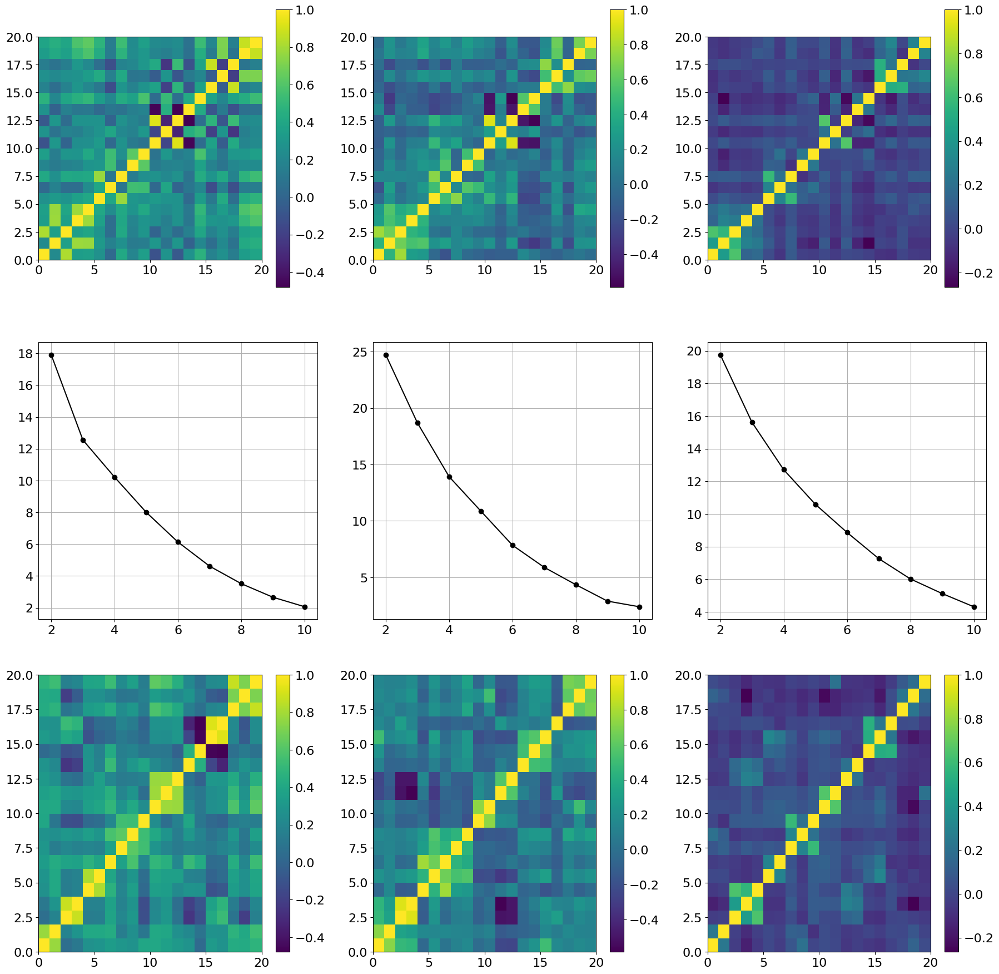

In [ ]:
# df
corrs = pd.DataFrame.corr(df)
plt.figure(figsize = (22,22))
plt.subplot(331)
plt.pcolor(corrs)
plt.axis('tight')
plt.axis('square')
plt.colorbar()

scores_kmeans = []
for n_clusters in range(2,11):
  model = KMeans(n_clusters = n_clusters)
  model.fit(corrs)
  scores_kmeans.append(model.inertia_)

model = KMeans(n_clusters = 8)
model.fit(corrs)
print(model.labels_)
plt.subplot(337)
plt.pcolor(pd.DataFrame.corr(df.T.iloc[argsort(model.labels_)].T))
plt.axis('tight')
plt.colorbar()

plt.subplot(334)
plt.plot(range(2,11),scores_kmeans,'k-o')
plt.grid()

# df_cut
corrs_cut = pd.DataFrame.corr(df_cut)
plt.subplot(332)
plt.pcolor(corrs_cut)
plt.axis('tight')
plt.axis('square')
plt.colorbar()

scores_kmeans = []
for n_clusters in range(2,11):
  model_cut = KMeans(n_clusters = n_clusters)
  model_cut.fit(corrs_cut)
  scores_kmeans.append(model_cut.inertia_)

model_cut = KMeans(n_clusters = 6)
model_cut.fit(corrs_cut)
print(model_cut.labels_)
plt.subplot(338)
plt.pcolor(pd.DataFrame.corr(df_cut.T.iloc[argsort(model_cut.labels_)].T))
plt.axis('tight')
plt.colorbar()

plt.subplot(335)
plt.plot(range(2,11),scores_kmeans,'k-o')
plt.grid()

# d_dfcut

corrs_dcut = pd.DataFrame.corr(d_dfcut)
plt.subplot(333)
plt.pcolor(corrs_dcut)
plt.axis('tight')
plt.axis('square')
plt.colorbar()

scores_kmeans = []
for n_clusters in range(2,11):
  model_dcut = KMeans(n_clusters = n_clusters)
  model_dcut.fit(corrs_dcut)
  scores_kmeans.append(model_dcut.inertia_)

model_dcut = KMeans(n_clusters = 8)
model_dcut.fit(corrs_dcut)
print(model_dcut.labels_)
plt.subplot(339)
plt.pcolor(pd.DataFrame.corr(d_dfcut.T.iloc[argsort(model_dcut.labels_)].T))
plt.axis('tight')
plt.colorbar()

plt.subplot(336)
plt.plot(range(2,11),scores_kmeans,'k-o')
plt.grid()
plt.savefig('correlations.png')
plt.show()

In [ ]:
# Dynamic Time Warping
for k in range(3):
  dtw_distance = pd.read_csv(f'{directory}/{["dtw_distances_df", "dtw_distances_dfcut", "dtw_distances_d_dfcut"][k]}.csv',index_col=0,header=0)
  dataframe = [df, df_cut, d_dfcut][k]
  count_progress = 0
  for i, j in itertools.product(range(1,21), range(1,21)):
    if i > j:
      count_progress += 1
      if dtw_distance.iloc[i-1, j-1] == 0:
        distance, path = fastdtw(dataframe[i], dataframe[j], dist=euclidean)
        print(f'\r({count_progress}/190, {count_progress/190*100:.1f}%) {round(distance)}',end='')
        dtw_distance.iloc[i-1, j-1] = distance
        dtw_distance.iloc[j-1, i-1] = distance
        dtw_distance.to_csv(f'{directory}/{["dtw_distances_df", "dtw_distances_dfcut", "dtw_distances_d_dfcut"][k]}.csv')
  print('\rDone! (190/190)')

Done! (190/190)
Done! (190/190)
Done! (190/190)


[0 2 0 1 1 0 2 0 1 1 0 1 0 1 1 0 2 0 1 1]
[0 1 0 2 2 0 1 0 2 2 0 1 0 2 2 0 1 0 2 2]
[1 1 1 0 0 2 2 2 0 0 0 0 0 0 0 2 2 2 0 0]


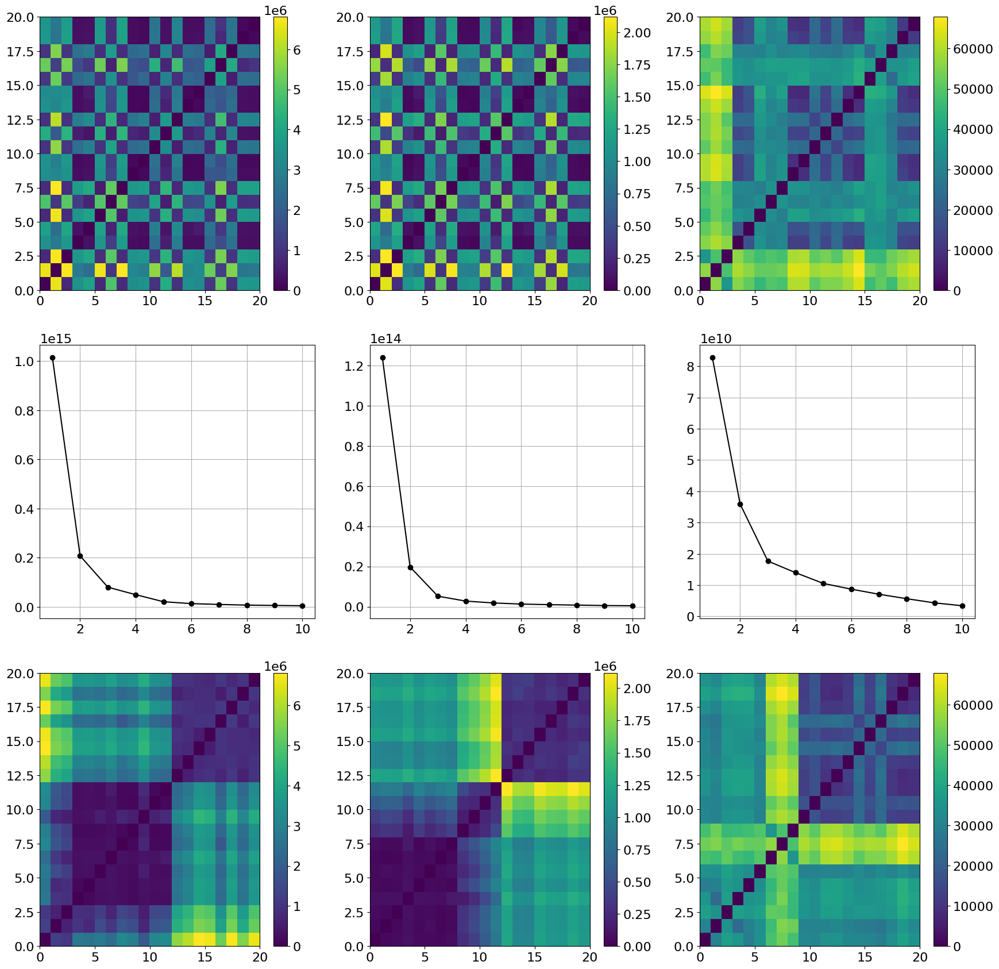

In [ ]:
dtw_distances_df = pd.read_csv(f'{directory}/dtw_distances_df.csv',index_col=0,header=0)
dtw_distances_dfcut = pd.read_csv(f'{directory}/dtw_distances_dfcut.csv',index_col=0,header=0)
dtw_distances_d_dfcut = pd.read_csv(f'{directory}/dtw_distances_d_dfcut.csv',index_col=0,header=0)
plt.figure(figsize=(21,21))
for k, dataframe in enumerate([dtw_distances_df, dtw_distances_dfcut, dtw_distances_d_dfcut]):
  plt.subplot(3,3,k+1)
  plt.pcolor(dataframe)
  plt.colorbar()

  scores_kmeans = []
  for n_clusters in range(1,11):
    model_dtw = KMeans(n_clusters = n_clusters)
    model_dtw.fit(dataframe)
    scores_kmeans.append(model_dtw.inertia_)

  model_dtw = KMeans(n_clusters = [3,3,3][k])
  model_dtw.fit(dataframe)
  print(model_dtw.labels_)
  plt.subplot(3,3,k+7)
  plt.pcolor((dataframe.T.iloc[argsort(model_dtw.labels_)[::-1],argsort(model_dtw.labels_)[::-1]].T))
  plt.axis('tight')
  plt.colorbar()

  plt.subplot(3,3,k+4)
  plt.plot(range(1,11),scores_kmeans,'k-o')
  plt.grid()
plt.savefig('dtw_distances.png')
plt.show()

In [ ]:
# Autocorrelations
def correlation(x,y, L):
    N = len(x)
    mx = mean(x)
    my = mean(y)
    Sx2 = sum(pow(x-mx,2))
    Sy2 = sum(pow(y-my,2))
    if L < 0:
        S = sum((x[-L:]-mx)*(y[:N+L]-my))
    else:
        S = sum((x[:N-L]-mx)*(y[L:]-my))
    return S/sqrt(Sx2*Sy2)

correlations = lambda x, y, max_t: (arange(-max_t, max_t+delta_t/2, delta_t), array([correlation(x, y, round(t/delta_t)) for t in arange(-max_t, max_t+delta_t/2, delta_t)]))

autocorrelations = {i: dict() for i in range(1,21)}
max_t = 10e-6
plt.figure(figsize=(100,100))
pairs = [(1, 1), (2, 2), (3, 3), (4, 4), (0, 0), (1, 3), (2, 4), (2, 0), (4, 0)]
for i, j in itertools.product(range(1,21),range(1,21)):
  desvios, autocorrelations[i][j] = correlations(array(df_cut[i]), array(df_cut[j]), max_t)
  if (i%5,j%5) in pairs or (j%5,i%5) in pairs:
    plt.subplot(20,20,20*(i-1)+j)
    plt.plot(desvios*1e6, autocorrelations[i][j],'k-')
    plt.grid()
    plt.legend([f'({i}, {j})'], loc = 'upper right')
plt.savefig('timelagged_corrs.png')
plt.show()

Máximo de correlação entre 1 e 3: -0.47 us
Half length: 5.68
Máximo de correlação entre 6 e 8: 0.11 us
Half length: 8.00
Máximo de correlação entre 11 e 13: 0.74 us
Half length: 11.67
Máximo de correlação entre 16 e 18: 1.15 us
Half length: 7.38
Average: 0.30 pm 0.59 us


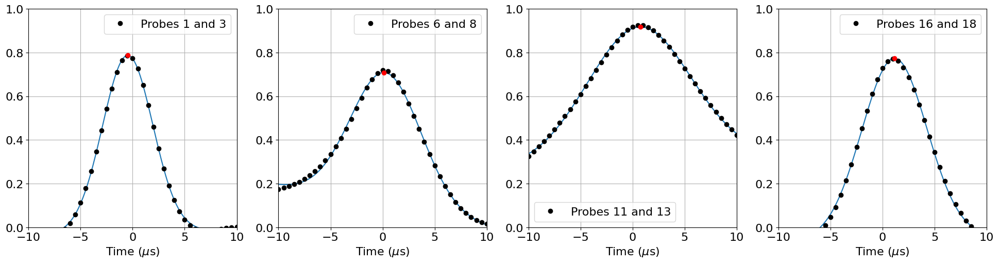

Máximo de correlação entre 4 e 5: 0.32 us
Half length: 8.07
Máximo de correlação entre 9 e 10: 0.11 us
Half length: 8.13
Máximo de correlação entre 14 e 15: 0.13 us
Half length: 8.84
Máximo de correlação entre 19 e 20: 0.26 us
Half length: 9.30
Average: 0.20 pm 0.13 us


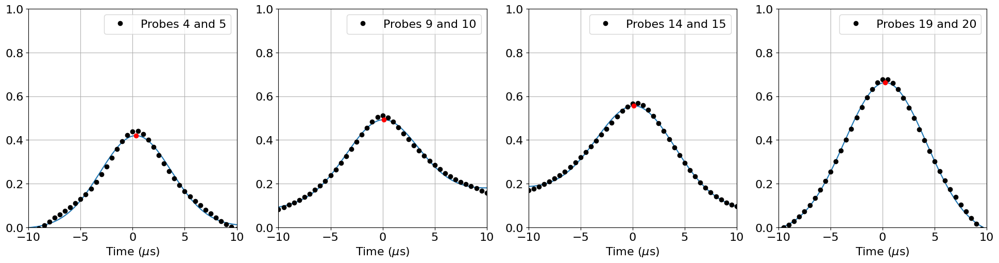

In [ ]:
gaussian_plus_line = lambda x, a, b, A, mu, s: a*x+b+A*exp(-pow((x-mu)/s,2)/2)
weighted_std = lambda a, w: sqrt(average(pow(a-average(a, weights = w),2),weights = w))

plt.figure(figsize = (24,5.5))
meanss, weights = [], []
for i in range(1,5):
  plt.subplot(1,4,i)
  a, b, A, mu, s = curve_fit(gaussian_plus_line, desvios*1e6, autocorrelations[5*(i-1)+1][5*(i-1)+3])[0]
  plt.plot(linspace(-max_t*1e6,max_t*1e6,150),gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,150),a, b, A, mu, s))
  plt.plot(desvios*1e6, autocorrelations[5*(i-1)+1][5*(i-1)+3],'ko', label = f'Probes {5*(i-1)+1} and {5*(i-1)+3}')
  plt.plot([linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]],[max(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))],'ro')
  print(f'Máximo de correlação entre {5*(i-1)+1} e {5*(i-1)+3}: {linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]:.2f} us')
  print(f'Half length: {2*sqrt(2*log(2))*s:.2f}')
  plt.xlabel('Time ($\mu$s)')
  plt.ylabel
  plt.legend()
  plt.axis([-max_t*1e6,max_t*1e6,0,1])
  plt.grid()
plt.savefig('corr_vf.png')
print(f'Average: {average([-0.45,0.18,0.72,1.04],weights = [1/5.74,1/6.98,1/9.29,1/7.19]):.2f} pm {weighted_std([-0.45,0.18,0.72,1.04],[1/5.74,1/6.98,1/9.29,1/7.19]):.2f} us')
plt.show()

plt.figure(figsize = (24,5.5))
for i in range(1,5):
  plt.subplot(1,4,i)
  a, b, A, mu, s = curve_fit(gaussian_plus_line, desvios*1e6, autocorrelations[5*(i-1)+4][5*(i-1)+5])[0]
  plt.plot(linspace(-max_t*1e6,max_t*1e6,150),gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,150),a, b, A, mu, s))
  plt.plot(desvios*1e6, autocorrelations[5*(i-1)+4][5*(i-1)+5],'ko', label = f'Probes {5*(i-1)+4} and {5*(i-1)+5}')
  plt.plot([linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]],[max(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))],'ro')
  print(f'Máximo de correlação entre {5*(i-1)+4} e {5*(i-1)+5}: {linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]:.2f} us')
  print(f'Half length: {2*sqrt(2*log(2))*s:.2f}')
  plt.xlabel('Time ($\mu$s)')
  plt.ylabel
  plt.legend()
  plt.axis([-max_t*1e6,max_t*1e6,0,1])
  plt.grid()
plt.savefig('corr_isat.png')
print(f'Average: {average([0.3,0,0.29,0.23],weights = [1/5.83,1/6.02,1/6.99,1/7.53]):.2f} pm {weighted_std([0.3,0,0.29,0.23],[1/5.83,1/6.02,1/6.99,1/7.53]):.2f} us')
plt.show()

In [ ]:
fft_correlations = {i: dict() for i in range(1,21)}
plt.figure(figsize=(100,100))
for i, j in itertools.product(range(1,21),range(1,21)):
  fft_correlations[i][j] = fft.fft(autocorrelations[i][j])
  if (i%5,j%5) in pairs or (j%5,i%5) in pairs:
    plt.subplot(20,20,20*(i-1)+j)
    plt.plot(arange(0,1/delta_t,1/(2*max_t))/1000, pow(abs(fft_correlations[i][j]),2),'k-')
    plt.grid()
    plt.xlabel('Frequency (kHz)')
    #plt.ylabel('FFT$_{corr}$' + f' (probes {i} and {j})')
    plt.axis([0,250,0, 1.1*max(pow(abs(fft_correlations[i][j]),2)[1:])])
plt.show()

#### Gradients

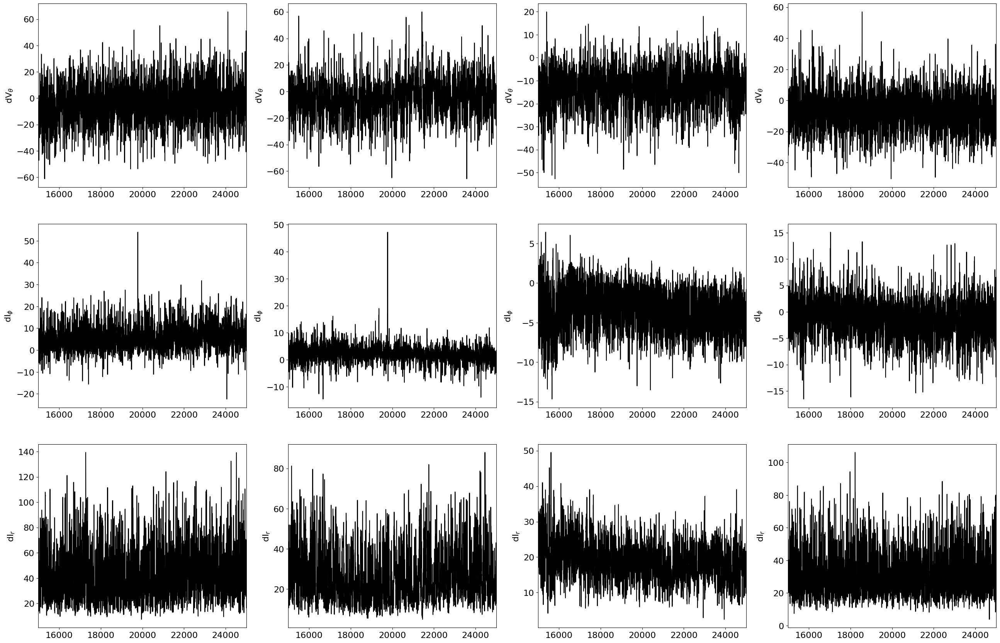

In [ ]:
plt.figure(figsize=(32,21))
dV_theta, dI_phi, dI_r = dict(), dict(), dict()
for group in range(1,5):
  sonda1, sonda2, sonda3, sonda4, sonda5 = df_cut[5*group-4], df_cut[5*group-3], df_cut[5*group-2], df_cut[5*group-1], df_cut[5*group]
  dV_theta[group] = sonda3-sonda1
  dI_phi[group] = sonda5 - sonda4
  dI_r[group] = sonda2-(sonda4+sonda5)/2
  plt.subplot(3,4,group)
  plt.plot(dV_theta[group],'k')
  plt.ylabel('dV$_{\\theta}$')
  plt.xlim([df_cut.index[0],df_cut.index[-1]])
  plt.subplot(3,4,group + 4)
  plt.plot(dI_phi[group],'k')
  plt.ylabel('dI$_{\\phi}$')
  plt.xlim([df_cut.index[0],df_cut.index[-1]])
  plt.subplot(3,4,group + 8)
  plt.plot(dI_r[group],'k')
  plt.ylabel('dI$_{r}$')
  plt.xlim([df_cut.index[0],df_cut.index[-1]])
plt.savefig('ds_dfcut.png')
plt.show()

Máximo de correlação entre (4, 5) e 2: -0.46 us
Half length: 6.18
Máximo de correlação entre (9, 10) e 7: -0.67 us
Half length: 6.74
Máximo de correlação entre (14, 15) e 12: 1.93 us
Half length: 5.76
Máximo de correlação entre (19, 20) e 17: 0.47 us
Half length: 8.12


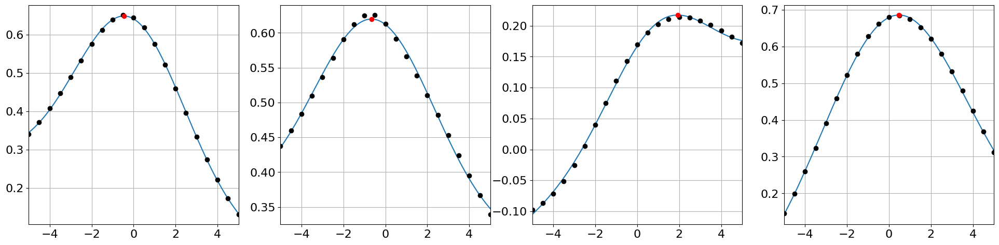

In [ ]:
plt.figure(figsize=(24,5.5))
max_t=5e-6
for i in range(1,5):
  plt.subplot(1,4,i)
  sonda1 = array(df_cut[4+5*(i-1)]+df_cut[5+5*(i-1)])/2
  sonda2 = array(df_cut[2+5*(i-1)])
  desvios, correlacao = correlations(sonda1, sonda2, max_t)
  a, b, A, mu, s = curve_fit(gaussian_plus_line, desvios*1e6, correlacao)[0]
  plt.plot(linspace(-max_t*1e6,max_t*1e6,150),gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,150),a, b, A, mu, s))
  plt.plot(desvios*1e6, correlacao,'ko')
  plt.plot([linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]],[max(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))],'ro')
  plt.grid()
  print(f'Máximo de correlação entre ({4+5*(i-1)}, {5+5*(i-1)}) e {2+5*(i-1)}: {linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]:.2f} us')
  print(f'Half length: {2*sqrt(2*log(2))*s:.2f}')
  plt.xlim([-5,5])
plt.savefig('corr_Ir.png')
plt.show()

Máximo de correlação entre 1 e 1: 0.00 us
Half length: 5.99
Máximo de correlação entre 1 e 2: 3.33 us
Half length: 21.93
Máximo de correlação entre 1 e 3: -5.37 us
Half length: 7.55
Máximo de correlação entre 1 e 4: 6.58 us
Half length: 29.40


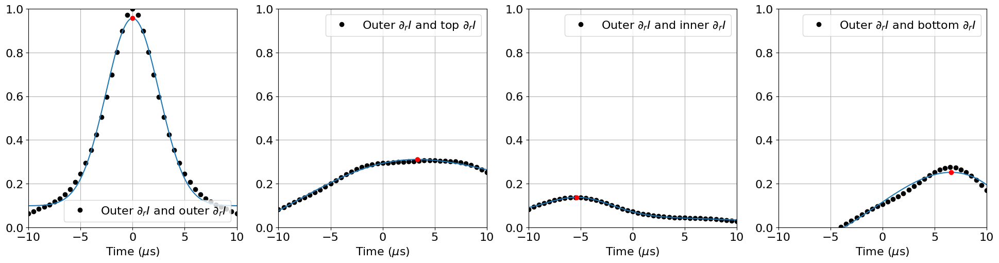

In [ ]:
plt.figure(figsize = (24,5.5))
max_t = 10e-6
for i in range(1,5):
  plt.subplot(1,4,i)
  desvios, correlacao = correlations(array(dI_r[1]), array(dI_r[i]), max_t)
  a, b, A, mu, s = curve_fit(gaussian_plus_line, desvios*1e6, correlacao, p0 = [0,0,max(correlacao),desvios[argmax(correlacao)]*1e6,1])[0]

  plt.plot(desvios*1e6, correlacao,'ko', label = f'Outer $\partial_rI$ and {[0, "outer", "top", "inner", "bottom"][i]} $\partial_rI$')
  plt.plot(linspace(-max_t*1e6,max_t*1e6,150),gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,150),a, b, A, mu, s))
  plt.plot([linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]],[max(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))],'ro')
  print(f'Máximo de correlação entre {1} e {i}: {linspace(-max_t*1e6,max_t*1e6,15000)[argmax(gaussian_plus_line(linspace(-max_t*1e6,max_t*1e6,15000),a, b, A, mu, s))]:.2f} us')
  print(f'Half length: {2*sqrt(2*log(2))*s:.2f}')
  plt.xlabel('Time ($\mu$s)')
  plt.ylabel
  if i == 1:
    plt.legend(loc='lower right')
  else:
    plt.legend()
  plt.axis([-max_t*1e6,max_t*1e6,0,1])
  plt.grid()
plt.savefig('corr_dIr.png')
plt.show()

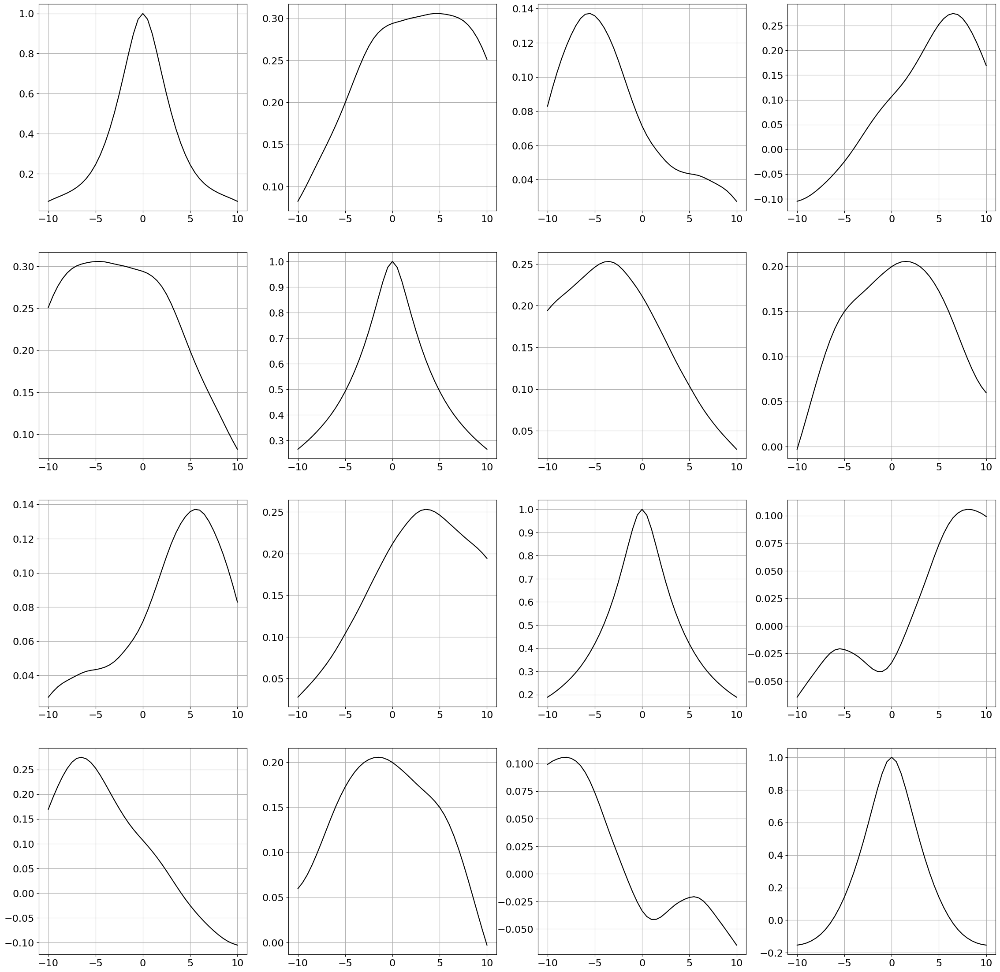


--------------------------------------



In [ ]:
correlations_grads = {i: dict() for i in range(1,5)}
max_t = 10e-6
for grad in [dI_r]: #[dV_theta, dI_phi, dI_r]
  plt.figure(figsize=(28,28))
  for i, j in itertools.product(grad.keys(), grad.keys()):
    desvios, correlations_grads[i][j] = correlations(array(grad[i]), array(grad[j]), max_t)
    plt.subplot(4,4,4*(i-1)+j)
    plt.plot(desvios*1e6, correlations_grads[i][j],'k-')
    plt.grid()
  plt.show()
  print('\n--------------------------------------\n')

### Markov Transition Field

df
Quantile


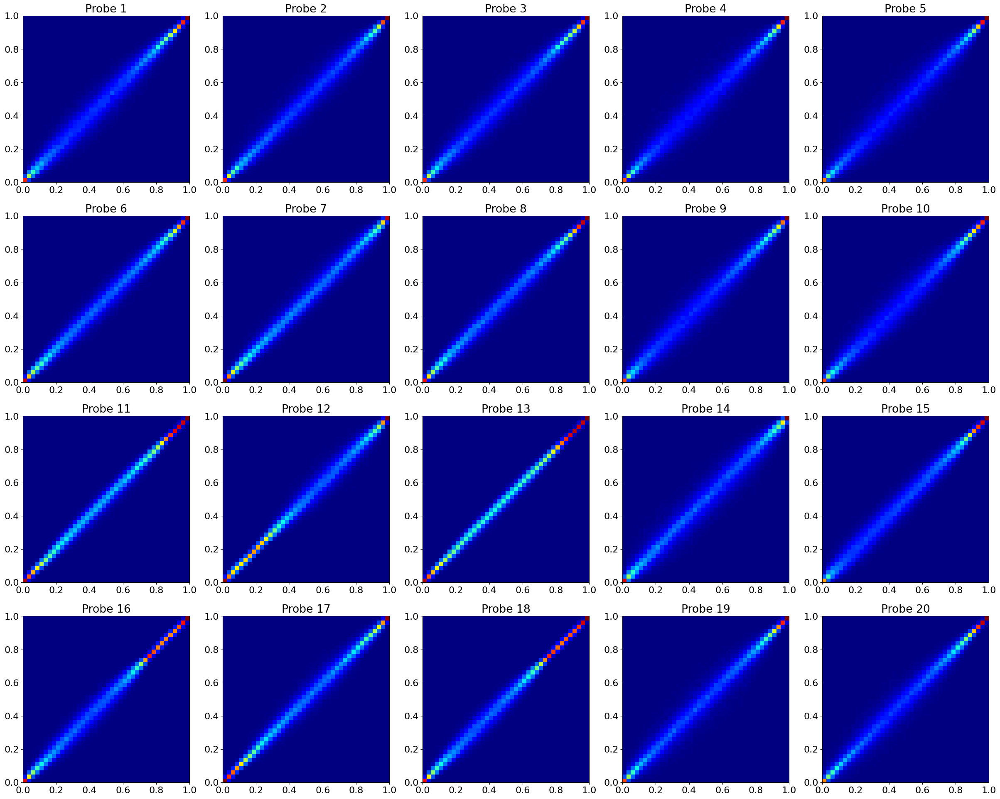

Normal


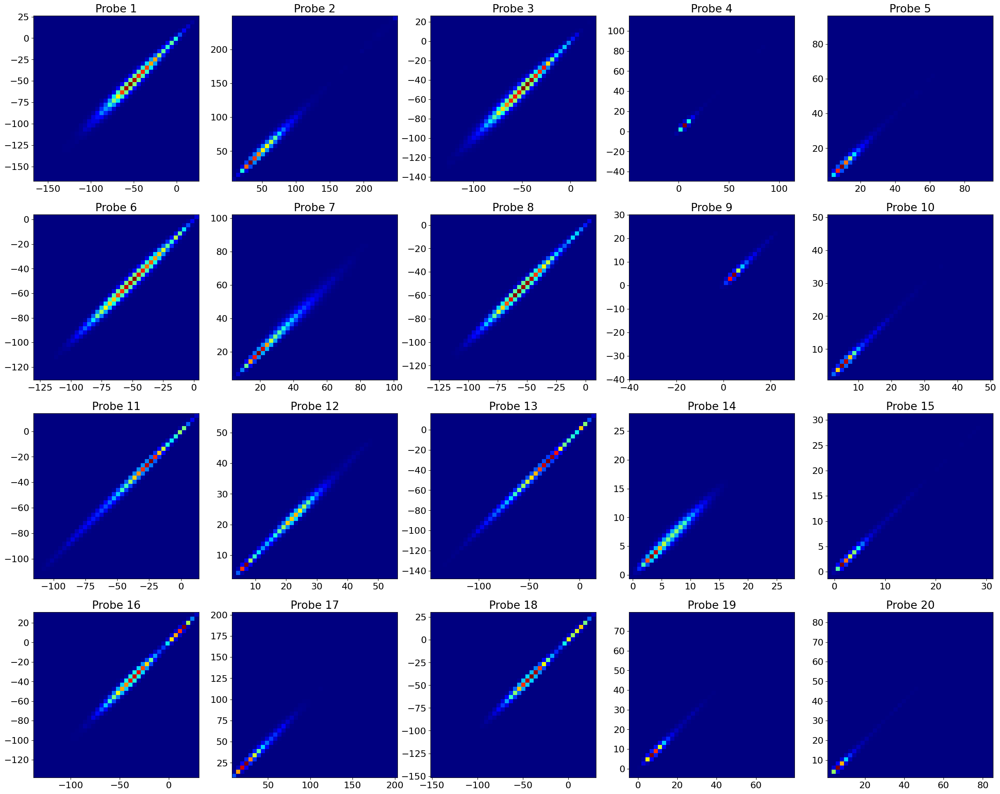

df_cut
Quantile


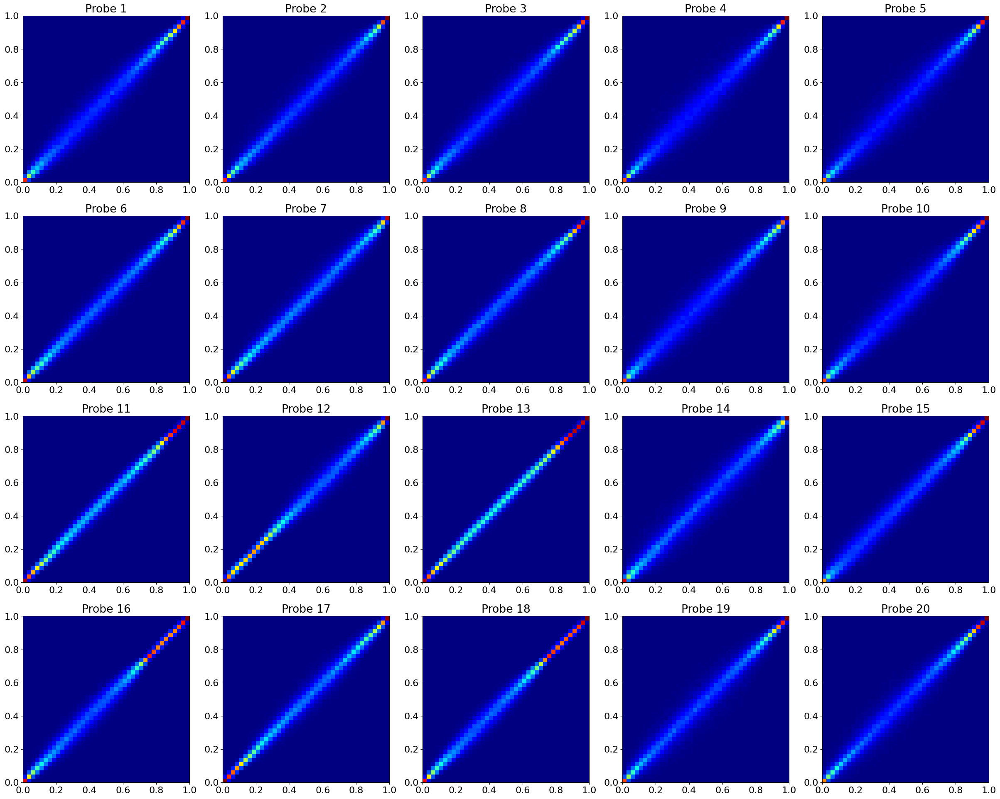

Normal


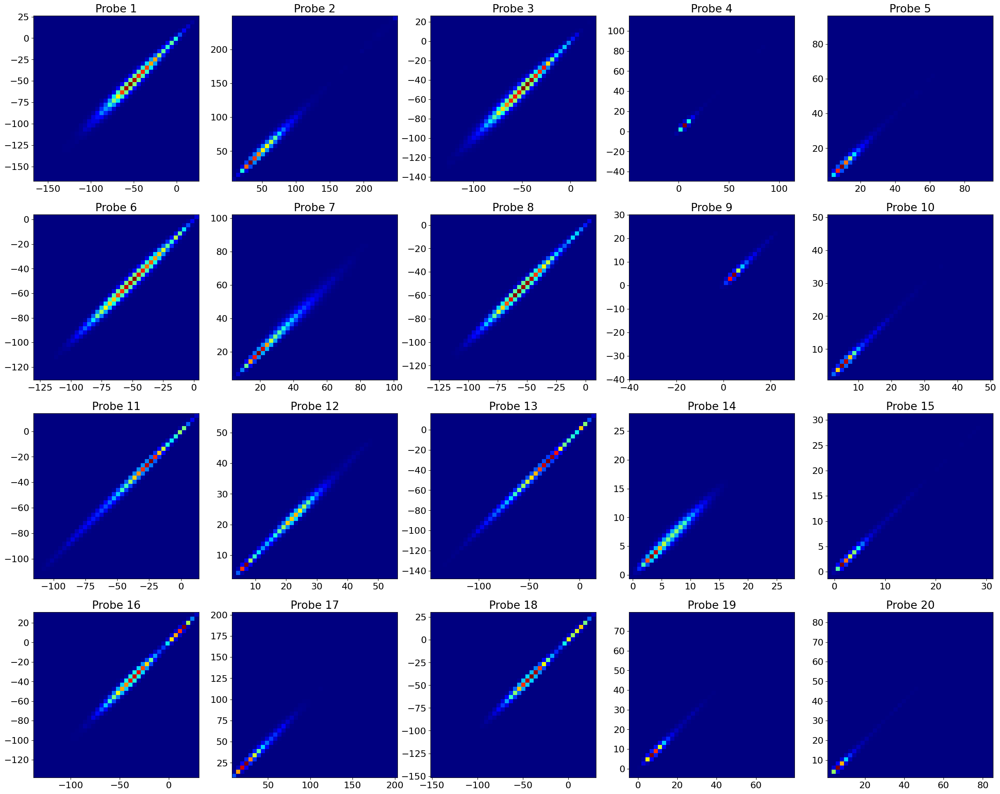

d_dfcut
Quantile


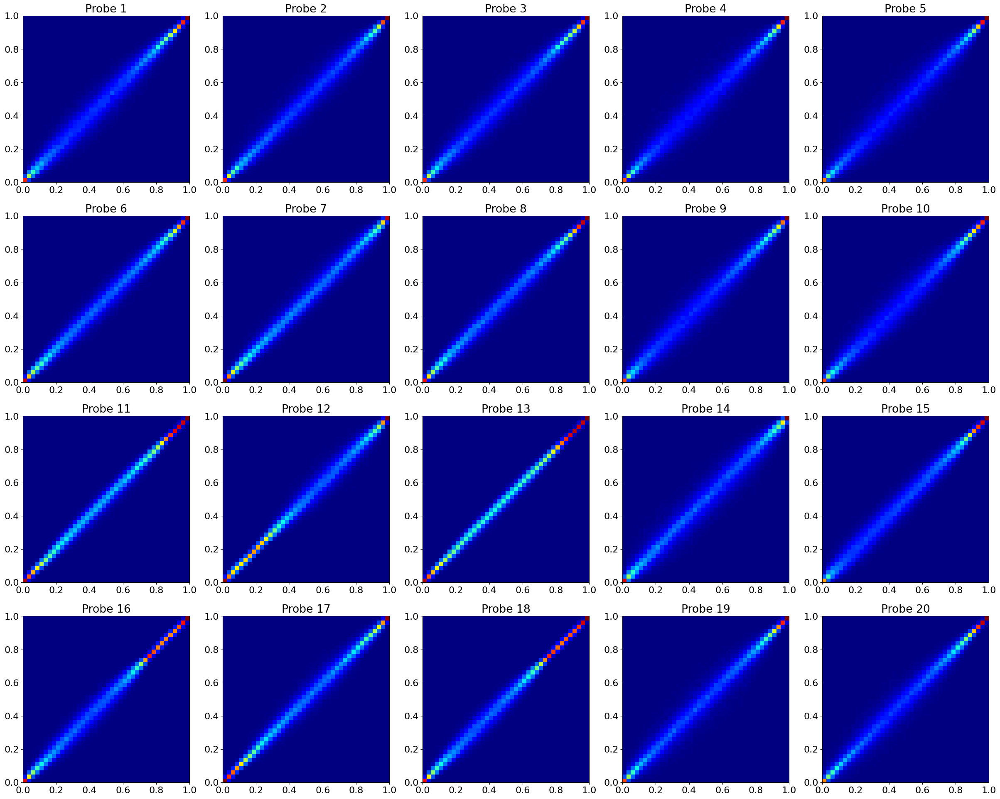

Normal


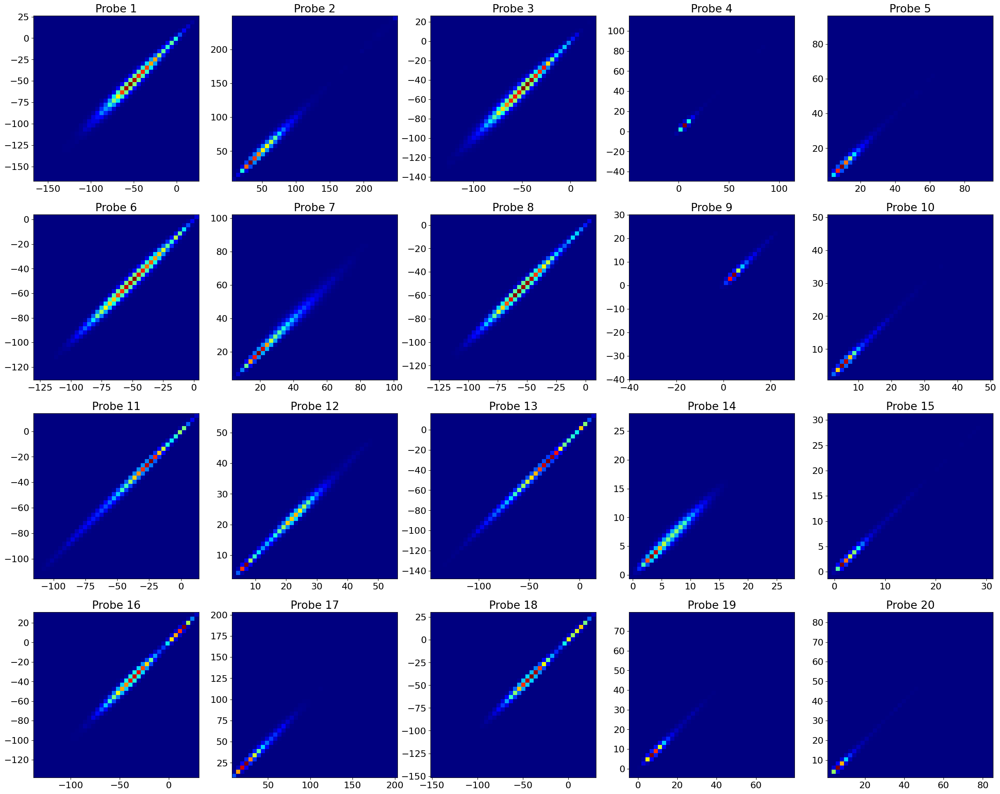

In [ ]:
def markov_transition_field(lista, n_bins, quantile=True):
  if quantile:
    f = interpolate.interp1d(sort(deepcopy(lista)),linspace(0,1,len(lista)))
    lista = f(lista)
  minx = min(lista)
  maxx = max(lista)
  bins = linspace(minx,maxx+1e-5,n_bins+1)
  point_bins = array([(bins[i]+bins[i-1])/2 for i in range(1, len(bins))])
  digitized_lista = digitize(lista, bins)
  pairs = [(digitized_lista[i-1], digitized_lista[i]) for i in range(1, len(lista))]
  transitions = {i: {j: 0 for j in range(1,n_bins+1)} for i in range(1,n_bins+1)}
  for i,j in pairs:
    transitions[i][j] += 1
  transitions = pd.DataFrame(transitions)
  transitions.index = point_bins
  transitions.columns = point_bins
  return bins, transitions

n_bins = 40
for k, dataframe in enumerate([df, df_cut, d_dfcut]):
  print(['df', 'df_cut', 'd_dfcut'][k])
  for quantile in [True, False]:
    print(['Normal','Quantile'][int(quantile)])
    plt.figure(figsize=(30,24))
    for i in range(1,21):
      plt.subplot(4,5,i)
      bins, transitions = markov_transition_field(df[i], n_bins = n_bins, quantile=quantile)
      X, Y = meshgrid(bins, bins)
      plt.pcolor(X, Y, transitions, cmap='jet')
      plt.axis('square')
      if quantile:
        plt.axis([0,1,0,1])
      plt.title(f'Probe {i}')
    plt.savefig(f'mtf_{["df", "dfcut", "ddfcut"][k]}_{["normal","quantile"][int(quantile)]}.png')
    plt.show()

### Dimensionality reduction

0.04417846199999076
48.802823902
37.6042853429999 

Epoch 1/50
1929/1929 [==============================] - 7s 3ms/step - loss: 0.0183 - mae: 0.0995 - val_loss: 0.0149 - val_mae: 0.0884
Epoch 2/50
1929/1929 [==============================] - 4s 2ms/step - loss: 0.0113 - mae: 0.0777 - val_loss: 0.0089 - val_mae: 0.0694
Epoch 3/50
1929/1929 [==============================] - 5s 3ms/step - loss: 0.0082 - mae: 0.0664 - val_loss: 0.0080 - val_mae: 0.0652
Epoch 4/50
1929/1929 [==============================] - 5s 2ms/step - loss: 0.0077 - mae: 0.0642 - val_loss: 0.0077 - val_mae: 0.0638
Epoch 5/50
1929/1929 [==============================] - 4s 2ms/step - loss: 0.0075 - mae: 0.0633 - val_loss: 0.0075 - val_mae: 0.0632
Epoch 6/50
1929/1929 [==============================] - 5s 3ms/step - loss: 0.0074 - mae: 0.0627 - val_loss: 0.0074 - val_mae: 0.0628
Epoch 7/50
1929/1929 [==============================] - 5s 3ms/step - loss: 0.0073 - mae: 0.0622 - val_loss: 0.0073 - val_mae: 0.0625
Epoch 8/50

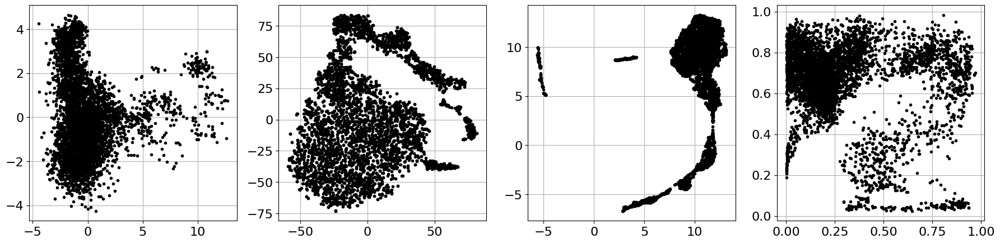

0.025717405000023064
45.79167041799997
10.101810770999919 

Epoch 1/50
626/626 [==============================] - 3s 3ms/step - loss: 0.0214 - mae: 0.1129 - val_loss: 0.0160 - val_mae: 0.0963
Epoch 2/50
626/626 [==============================] - 2s 3ms/step - loss: 0.0158 - mae: 0.0956 - val_loss: 0.0157 - val_mae: 0.0952
Epoch 3/50
626/626 [==============================] - 2s 3ms/step - loss: 0.0152 - mae: 0.0933 - val_loss: 0.0146 - val_mae: 0.0911
Epoch 4/50
626/626 [==============================] - 2s 3ms/step - loss: 0.0136 - mae: 0.0883 - val_loss: 0.0128 - val_mae: 0.0858
Epoch 5/50
626/626 [==============================] - 2s 4ms/step - loss: 0.0121 - mae: 0.0838 - val_loss: 0.0116 - val_mae: 0.0822
Epoch 6/50
626/626 [==============================] - 2s 3ms/step - loss: 0.0114 - mae: 0.0814 - val_loss: 0.0112 - val_mae: 0.0809
Epoch 7/50
626/626 [==============================] - 2s 3ms/step - loss: 0.0110 - mae: 0.0799 - val_loss: 0.0107 - val_mae: 0.0784
Epoch 8/50
626/6

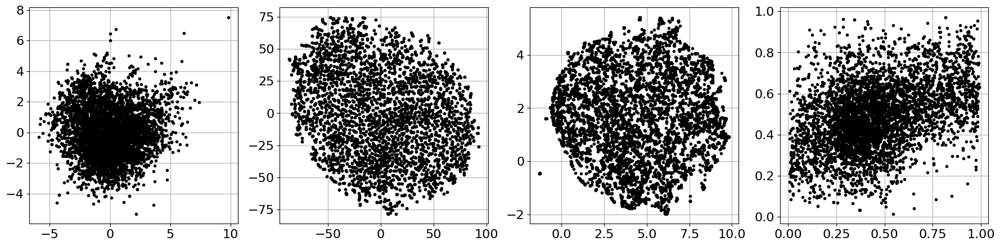

0.04033772599996155
52.14847604199986
11.005776511000022 

Epoch 1/50
625/625 [==============================] - 3s 3ms/step - loss: 0.0082 - mae: 0.0660 - val_loss: 0.0074 - val_mae: 0.0624
Epoch 2/50
625/625 [==============================] - 2s 3ms/step - loss: 0.0074 - mae: 0.0624 - val_loss: 0.0074 - val_mae: 0.0623
Epoch 3/50
625/625 [==============================] - 2s 3ms/step - loss: 0.0074 - mae: 0.0621 - val_loss: 0.0073 - val_mae: 0.0619
Epoch 4/50
625/625 [==============================] - 2s 3ms/step - loss: 0.0071 - mae: 0.0612 - val_loss: 0.0069 - val_mae: 0.0605
Epoch 5/50
625/625 [==============================] - 2s 3ms/step - loss: 0.0068 - mae: 0.0599 - val_loss: 0.0067 - val_mae: 0.0596
Epoch 6/50
625/625 [==============================] - 2s 3ms/step - loss: 0.0066 - mae: 0.0591 - val_loss: 0.0064 - val_mae: 0.0585
Epoch 7/50
625/625 [==============================] - 2s 4ms/step - loss: 0.0062 - mae: 0.0574 - val_loss: 0.0059 - val_mae: 0.0562
Epoch 8/50
625/62

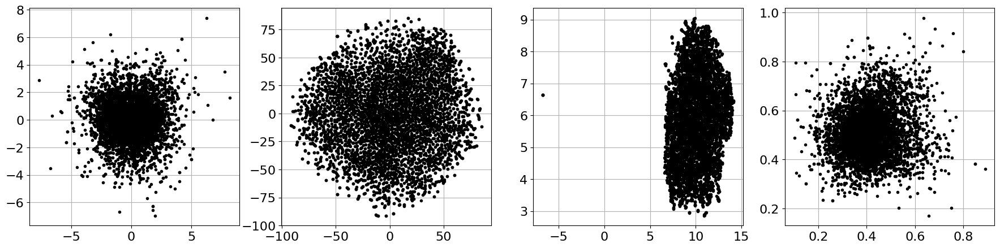

In [ ]:
dfs_reduced = []
for k, dataframe in enumerate([df, df_cut, d_dfcut]):
  scaler = StandardScaler()
  scaled_df = scaler.fit_transform(dataframe)
  inds = random.randint(0, scaled_df.shape[0], size=5000)
  reduced_df = scaled_df[inds]

  tempo1 = perf_counter()
  df_pca = PCA(n_components=2).fit_transform(reduced_df)
  print(perf_counter()-tempo1)

  tempo1 = perf_counter()
  df_tsne = TSNE(n_components=2).fit_transform(reduced_df)
  print(perf_counter()-tempo1)

  tempo1 = perf_counter()
  df_umap = umap.UMAP(n_components=2).fit_transform(reduced_df)
  print(perf_counter()-tempo1,'\n')

  encoder = Sequential([Dense(12, input_shape=(20,), activation='sigmoid'), Dense(2, activation='sigmoid')])
  decoder = Sequential([Dense(12, input_shape=(2,), activation='sigmoid'), Dense(20, activation='sigmoid')])
  autoencoder = Sequential([encoder, decoder])
  scaler = MinMaxScaler()
  scaled_df = scaler.fit_transform(dataframe)
  scaled_dfcut = scaler.transform(dataframe.iloc[inds])
  autoencoder.compile(optimizer='adam', loss='mse', metrics=['mae'])
  history = autoencoder.fit(scaled_df, scaled_df, epochs=50, batch_size=32, validation_data=(scaled_dfcut, scaled_dfcut))
  encoded_df = encoder.predict(scaled_dfcut, verbose=0)

  plt.figure(figsize=(22,5))
  plt.subplot(141)
  plt.plot(df_pca[:,0], df_pca[:,1],'k.')
  plt.grid()
  plt.subplot(142)
  plt.plot(df_tsne[:,0], df_tsne[:,1],'k.')
  plt.grid()
  plt.subplot(143)
  plt.plot(df_umap[:,0], df_umap[:,1],'k.')
  plt.grid()
  plt.subplot(144)
  plt.plot(encoded_df[:,0], encoded_df[:,1], 'k.')
  plt.grid()
  plt.savefig(f'reduced_df{k+1}.png')
  plt.show()
  #dfs_reduced.append([df_pca, df_umap])

### Distribution statistics

Sonda 1/20
1.980 -1.000 -49.15 13.13
1.949 -0.996 -49.15 13.28

Sonda 2/20
1.827 1.000 51.70 13.97
1.353 1.000 64.41 13.24

Sonda 3/20
1.963 -1.000 -53.80 14.17
1.778 -1.000 -55.89 14.50

Sonda 4/20
1.665 0.645 6.61 2.09
1.341 0.800 7.78 1.75

Sonda 5/20
1.813 1.000 12.28 3.49
1.466 1.000 14.01 3.28

Sonda 6/20
2.000 -0.235 -48.22 13.68
1.722 -1.000 -51.02 13.96

Sonda 7/20
1.816 1.000 30.98 8.73
1.532 0.974 31.43 7.85

Sonda 8/20
2.000 0.756 -52.24 11.64
2.000 0.756 -51.03 12.01

Sonda 9/20
1.729 0.855 4.85 1.73
1.185 0.949 8.12 1.39

Sonda 10/20
1.806 1.000 7.05 1.61
1.498 1.000 7.68 1.46

Sonda 11/20
2.000 0.049 -41.23 13.56
1.281 -1.000 -57.22 11.42

Sonda 12/20
1.919 1.000 23.82 3.49
1.803 1.000 24.13 3.45

Sonda 13/20
1.879 -1.000 -54.24 13.64
1.386 -1.000 -65.96 13.31

Sonda 14/20
1.975 1.000 6.93 2.12
2.000 0.999 6.78 2.32

Sonda 15/20
1.910 1.000 3.57 1.19
1.827 1.000 3.61 1.25

Sonda 16/20
1.910 -1.000 -40.06 10.75
1.695 -1.000 -42.23 10.67

Sonda 17/20
1.776 1.000 39.88 9.46

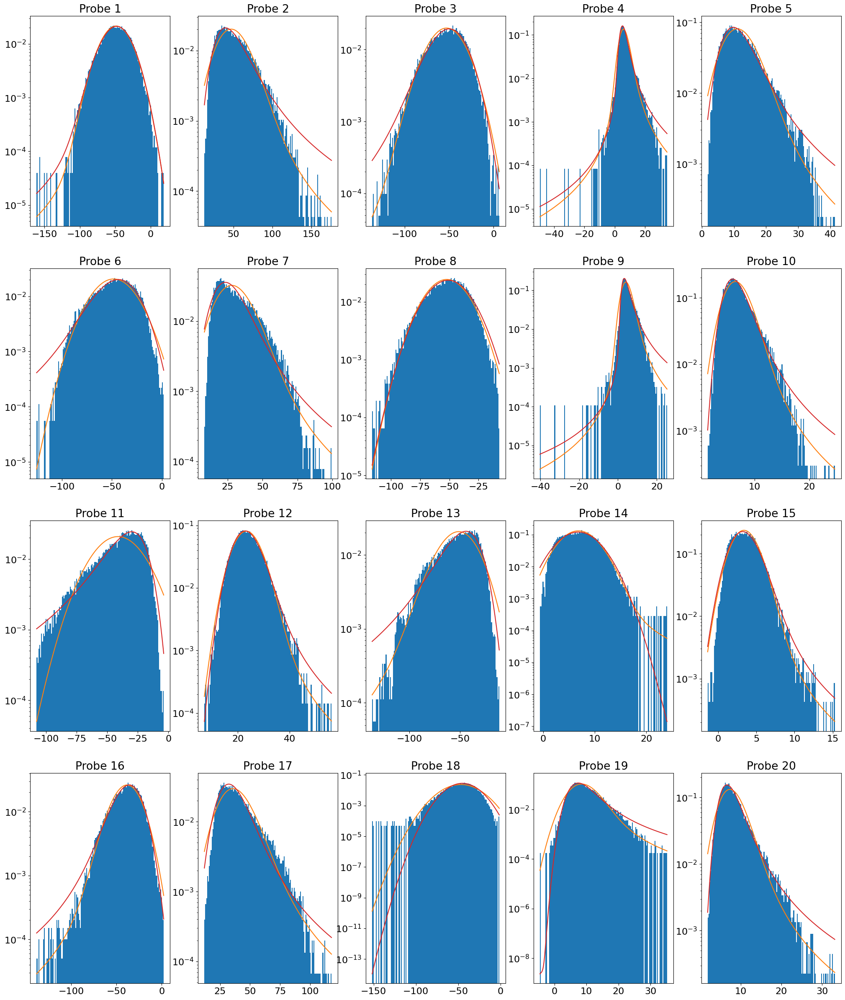

In [ ]:
levy_params = lambda lista: fit_levy(lista, mu = mean(lista))[0].get()
minimize_levypdf = lambda x0, y0: lambda x: sum(pow(y0-levy_stable.pdf(x0,x[0],x[1],x[2],x[3]), 2))
df_levy1 = pd.read_csv(f'{directory}/alpha_stable_params_from_MLE.csv',index_col=0,header=0)
df_levy2 = pd.read_csv(f'{directory}/alpha_stable_params_from_MSE.csv',index_col=0,header=0)

# Alpha Stable for values (log)
plt.figure(figsize=(25,30))
levyfit_params1, levyfit_params2 = dict(), dict()
for i in range(1,21):
  print(f'\rSonda {i}/20',end='')
  alpha, beta, mu, c = array(df_levy1[str(i)]) #levy_params(df_cut[i])
  levyfit_params1[i] = [alpha, beta, mu, c]
  print(f'\n{alpha:.3f} {beta:.3f} {mu:.2f} {c:.2f}')

  plt.subplot(4,5,i)
  n, bins, _ = plt.hist(df_cut[i], bins = round(sqrt(len(df_cut[i]))), log=True, density = True)
  plt.plot(linspace(min(df_cut[i]), max(df_cut[i]), 250), levy_stable.pdf(linspace(min(df_cut[i]), max(df_cut[i]), 250), alpha, beta, mu, c), color='tab:orange')

  alpha_n, beta_n, mu_n, c_n = array(df_levy2[str(i)]) #minimize(minimize_levypdf([(bins[i]+bins[i-1])/2 for i in range(1,len(bins))],n),x0=[alpha,beta,mu,c],bounds=((0.5,2),(-1,1),(None,None),(None,None))).x
  levyfit_params2[i] = [alpha_n, beta_n, mu_n, c_n]
  print(f'{alpha_n:.3f} {beta_n:.3f} {mu_n:.2f} {c_n:.2f}\n')

  plt.plot(linspace(min(df_cut[i]), max(df_cut[i]), 250), levy_stable.pdf(linspace(min(df_cut[i]), max(df_cut[i]), 250), alpha_n, beta_n, mu_n, c_n), color='tab:red')
  plt.title(f'Probe {i}')

#dflevy1 = pd.DataFrame(levyfit_params1, index = ['alpha','beta','mu','c'])
#dflevy1.to_csv(f'{directory}/alpha_stable_params_from_MLE.csv')
#dflevy2 = pd.DataFrame(levyfit_params2, index = ['alpha','beta','mu','c'])
#dflevy2.to_csv(f'{directory}/alpha_stable_params_from_MSE.csv')
plt.savefig('dist_probes_log.png')
plt.show()

Sonda 20/20

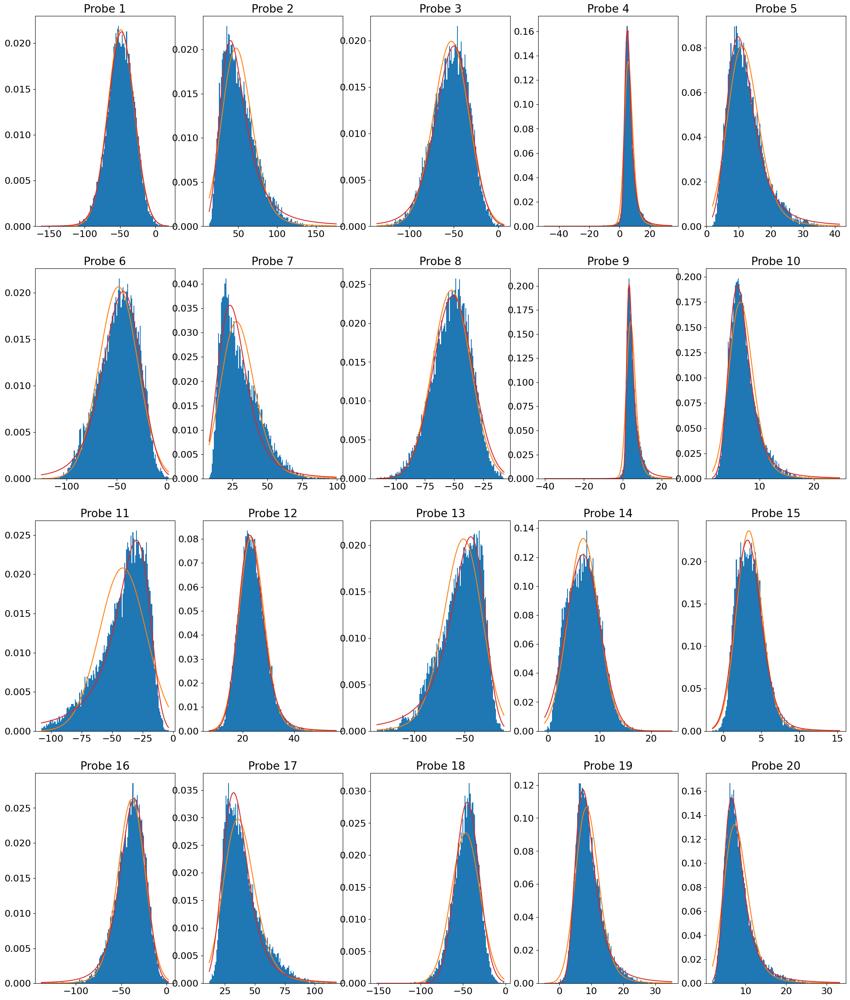

In [ ]:
# Alpha Stable for values (not log)
plt.figure(figsize=(25,30))
for i in range(1,21):
  print(f'\rSonda {i}/20',end='')
  plt.subplot(4,5,i)
  plt.hist(df_cut[i], bins = round(sqrt(len(df_cut[i]))), density = True)
  alpha, beta, mu, c = levyfit_params1[i]
  plt.plot(linspace(min(df_cut[i]), max(df_cut[i]), 200), levy_stable.pdf(linspace(min(df_cut[i]), max(df_cut[i]), 200), alpha, beta, mu, c), color='tab:orange')
  alpha, beta, mu, c = levyfit_params2[i]
  plt.plot(linspace(min(df_cut[i]), max(df_cut[i]), 200), levy_stable.pdf(linspace(min(df_cut[i]), max(df_cut[i]), 200), alpha, beta, mu, c), color='tab:red')
  plt.title(f'Probe {i}')
plt.savefig('dist_probes.png')
plt.show()

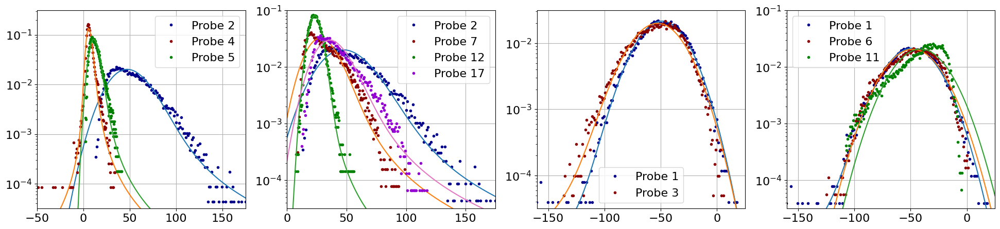

In [ ]:
plots = [[2,4,5],[2,7,12,17],[1,3],[1,6,11]]
color_points = ['darkblue', 'darkred', 'g', 'darkviolet']
color_lines = ['tab:blue', 'tab:orange', 'tab:green', 'tab:pink']
plt.figure(figsize=(24,5))
for kk, plot in enumerate(plots):
  minx, maxx = [-50,0,-160,-160], [175,175,25,25]
  plt.subplot(1,4,kk+1)
  for k, probe in enumerate(plot):
    hist, bins = histogram(df_cut[probe], bins = round(sqrt(len(df_cut[probe]))), density = True)
    bins = [(bins[i-1]+bins[i])/2 for i in range(1,len(bins))]
    plt.semilogy(bins, hist,'.',color = color_points[k], label = f'Probe {probe}')
    alpha, beta, mu, c = levyfit_params1[probe]
    plt.semilogy(linspace(minx[kk], maxx[kk], 200), levy_stable.pdf(linspace(minx[kk], maxx[kk], 200), alpha, beta, mu, c), color = color_lines[k])
  plt.grid()
  plt.axis([minx[kk], maxx[kk],[10**(-4.5), 10**(-4.5), 10**(-4.5), 10**(-4.5)][kk], [3.1e-1,1e-1,3.12e-2,1e-1][kk]])
  plt.legend()
plt.savefig('dist_probes_compared.png')
plt.show()

In [ ]:
df_cut.describe().append(pd.DataFrame.skew(df_cut).rename('skewness')).append(pd.DataFrame.kurt(df_cut).rename('kurtosis')).append(pd.DataFrame(levyfit_params1, index = ['alpha_MLE','beta_MLE','mu_MLE','c_MLE']).iloc[[0,1,3]]).append(pd.DataFrame(levyfit_params2, index = ['alpha_MSE','beta_MSE','mu_MSE','c_MSE'])).iloc[1:]

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
mean,-49.147341,51.696262,-53.804782,6.614691,12.279922,-48.222714,30.978654,-52.236083,4.854176,7.054376,-41.233276,23.816594,-54.239777,6.930088,3.571317,-40.060595,39.880280,-46.965798,9.401472,8.369330
std,18.804315,21.661627,20.361257,3.943883,5.481495,19.343411,13.425815,16.457279,2.960466,2.563640,19.171308,5.202055,20.314971,3.052831,1.799431,16.167906,15.044996,14.845363,4.201970,3.622586
min,-160.963806,12.770322,-136.520370,-49.392258,1.822465,-125.250351,8.380416,-116.155998,-40.154026,1.385431,-107.795403,7.069376,-136.980377,-0.632838,-1.381061,-138.097092,11.907910,-151.684952,-4.530728,1.851251
25%,-61.257641,35.250694,-67.440849,4.314875,8.294146,-61.278458,20.346453,-63.146137,2.930179,5.277584,-52.225063,20.273737,-66.908295,4.570035,2.231040,-49.827332,28.627211,-55.985241,6.444646,5.937726
50%,-48.800087,47.689198,-52.377094,5.861829,11.351857,-46.670025,28.037407,-51.157238,4.200892,6.592114,-37.271805,23.413370,-51.114883,6.919043,3.436978,-38.364246,36.710621,-45.558540,8.618384,7.562790
75%,-35.944363,64.229416,-38.946026,8.039377,15.219243,-33.757145,39.369038,-40.370472,6.210790,8.314339,-26.603153,26.918783,-38.426807,9.048963,4.686735,-28.621481,47.651703,-36.718803,11.645614,9.873695
max,18.498146,175.840652,6.390027,34.438576,41.393635,1.758030,99.410683,-7.200490,25.290529,24.683098,-3.802722,56.242332,-11.059813,23.998411,15.277276,2.157579,117.889526,-1.594175,35.156654,33.152313
skewness,-0.226364,0.961788,-0.337538,1.041335,1.022967,-0.353314,0.909146,-0.299207,0.624257,1.129413,-0.856485,0.599225,-0.682518,0.308570,0.729688,-0.714988,1.101789,-0.671416,1.113096,1.563381
kurtosis,0.232085,1.078334,-0.060362,9.327723,1.297715,-0.325741,0.532353,-0.105022,7.659917,1.928677,0.302389,1.093040,0.099204,0.049520,1.345229,1.334388,1.257656,1.658162,2.043090,3.733376
alpha_MLE,1.980206,1.826511,1.962958,1.664602,1.813190,2.000000,1.816204,2.000000,1.729143,1.805619,2.000000,1.918969,1.879106,1.975478,1.910039,1.910147,1.775567,2.000000,1.818455,1.747265


Sonda 1/20
1.911 0.251 -2.293e-03 2.99
1.658 0.234 1.699e-01 2.81

Sonda 2/20
1.718 0.154 -3.165e-03 2.92
1.364 0.104 1.080e-01 2.68

Sonda 3/20
1.837 0.162 -2.018e-03 2.93
1.579 0.129 8.081e-02 2.76

Sonda 4/20
1.493 0.024 -4.791e-04 0.52
1.348 0.017 -2.344e-02 0.50

Sonda 5/20
1.767 0.085 -1.452e-04 0.88
1.507 0.096 2.578e-02 0.83

Sonda 6/20
1.931 -0.345 2.343e-03 2.09
1.721 -0.200 -5.970e-02 1.99

Sonda 7/20
1.570 0.099 7.658e-04 1.41
1.174 0.024 -7.081e-02 1.28

Sonda 8/20
1.856 -0.298 1.199e-04 1.86
1.681 -0.609 -3.011e-01 1.78

Sonda 9/20
1.630 0.000 2.686e-05 0.39
1.460 -0.099 -4.559e-02 0.38

Sonda 10/20
1.742 0.220 -5.039e-05 0.40
1.742 0.220 -5.039e-05 0.40

Sonda 11/20
1.863 -0.196 2.853e-04 1.35
1.614 -0.057 2.376e-02 1.27

Sonda 12/20
1.780 0.145 5.906e-06 0.71
1.625 0.212 3.546e-02 0.68

Sonda 13/20
1.851 -0.392 -4.287e-06 1.40
1.717 -0.321 -2.500e-02 1.34

Sonda 14/20
1.929 0.005 -2.255e-04 0.52
1.929 0.005 -2.255e-04 0.52

Sonda 15/20
1.905 0.290 1.386e-04 0.25
1.905 0

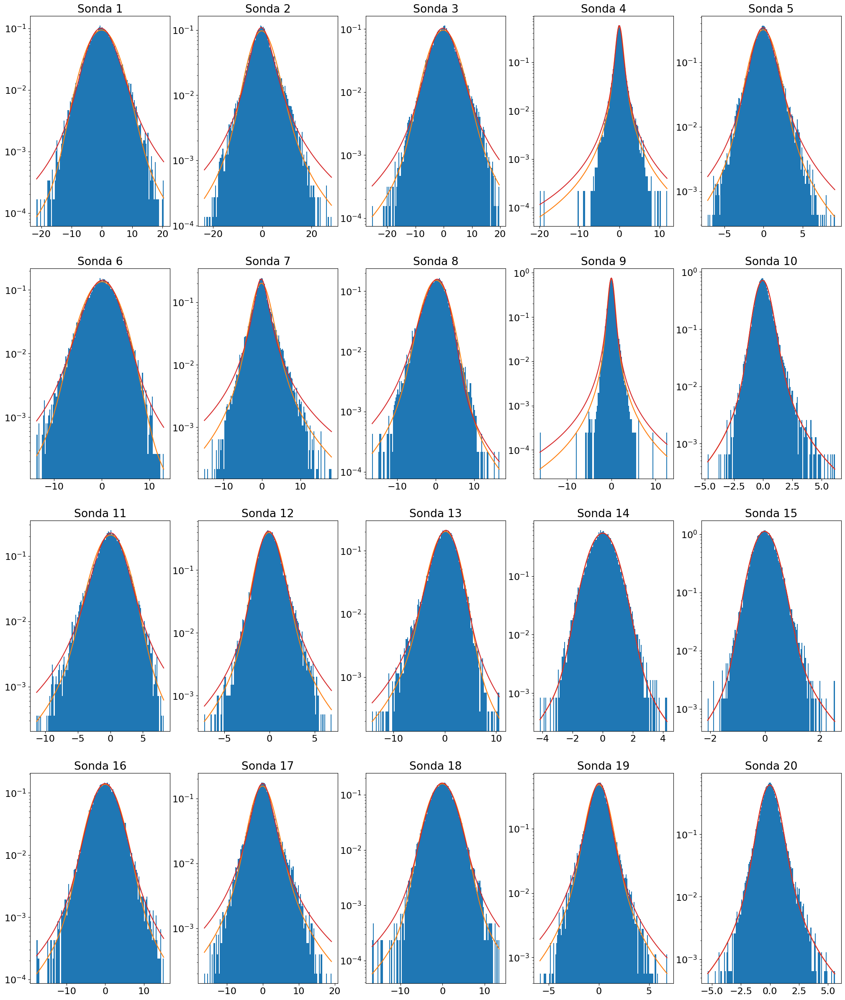

In [ ]:
# Alpha Stable for changes (log)
df_levy1 = pd.read_csv(f'{directory}/alpha_stable_dparams_from_MLE.csv',index_col=0,header=0)
df_levy2 = pd.read_csv(f'{directory}/alpha_stable_dparams_from_MSE.csv',index_col=0,header=0)
plt.figure(figsize=(25,30))
levyfit_dparams1, levyfit_dparams2 = dict(), dict()
for i in range(1,21):
  print(f'\rSonda {i}/20',end='')
  alpha, beta, mu, c = array(df_levy1[str(i)]) #levy_params(d_dfcut[i])
  levyfit_dparams1[i] = [alpha, beta, mu, c]
  print(f'\n{alpha:.3f} {beta:.3f} {mu:.3e} {c:.2f}')

  plt.subplot(4,5,i)
  n, bins, _ = plt.hist(d_dfcut[i], bins = round(sqrt(len(d_dfcut[i]))), log=True, density = True)
  plt.plot(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 250), levy_stable.pdf(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 250), alpha, beta, mu, c), color='tab:orange')

  alpha_n, beta_n, mu_n, c_n = array(df_levy2[str(i)]) #minimize(minimize_levypdf([(bins[i]+bins[i-1])/2 for i in range(1,len(bins))],n),x0=[alpha,beta,mu,c],bounds=((0.5,2),(-1,1),(None,None),(None,None))).x
  levyfit_dparams2[i] = [alpha_n, beta_n, mu_n, c_n]
  print(f'{alpha_n:.3f} {beta_n:.3f} {mu_n:.3e} {c_n:.2f}\n')

  plt.plot(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 250), levy_stable.pdf(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 250), alpha_n, beta_n, mu_n, c_n), color='tab:red')
  plt.title(f'Sonda {i}')

#df_dlevy1 = pd.DataFrame(levyfit_dparams1, index = ['alpha','beta','mu','c'])
#df_dlevy1.to_csv(f'{directory}/alpha_stable_dparams_from_MLE.csv')
#df_dlevy2 = pd.DataFrame(levyfit_dparams2, index = ['alpha','beta','mu','c'])
#df_dlevy2.to_csv(f'{directory}/alpha_stable_dparams_from_MSE.csv')
plt.savefig('dist_dprobes_log.png')
plt.show()

Sonda 20/20

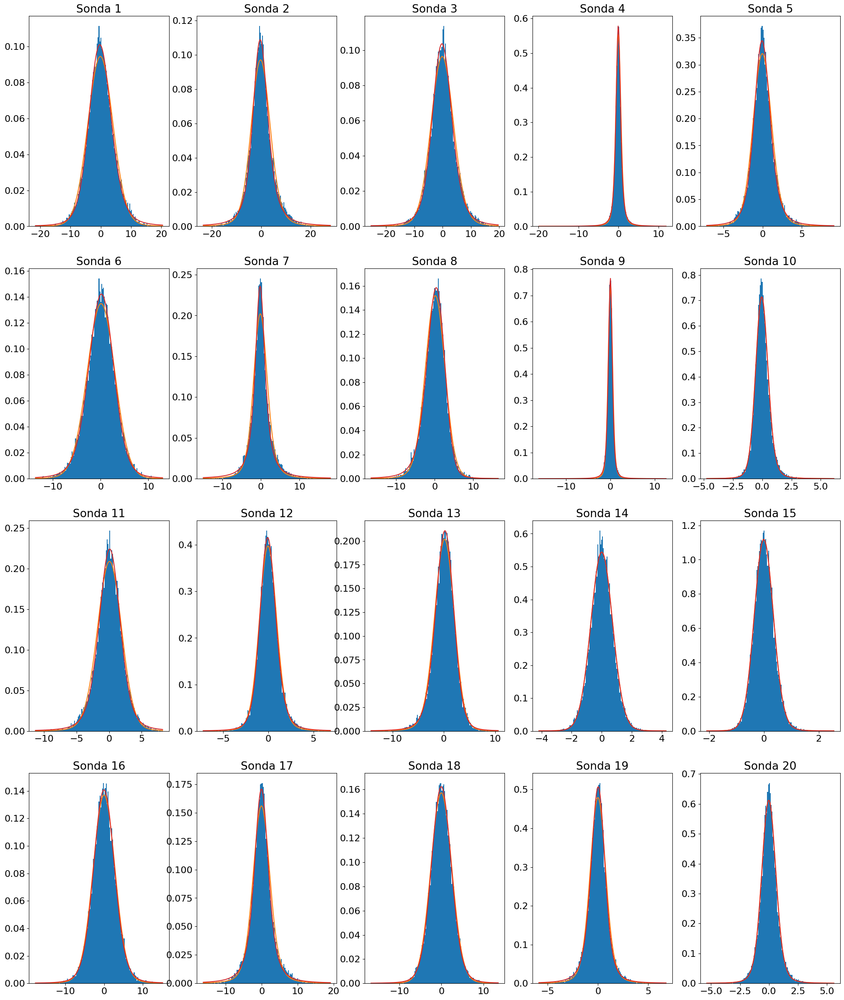

In [ ]:
# Alpha Stable for changes (not log)
plt.figure(figsize=(25,30))
for i in range(1,21):
  print(f'\rSonda {i}/20',end='')
  plt.subplot(4,5,i)
  plt.hist(d_dfcut[i], bins = round(sqrt(len(d_dfcut[i]))), density = True)
  alpha, beta, mu, c = levyfit_dparams1[i]
  plt.plot(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 200), levy_stable.pdf(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 200), alpha, beta, mu, c), color='tab:orange')
  alpha, beta, mu, c = levyfit_dparams2[i]
  plt.plot(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 200), levy_stable.pdf(linspace(min(d_dfcut[i]), max(d_dfcut[i]), 200), alpha, beta, mu, c), color='tab:red')
  plt.title(f'Sonda {i}')
plt.savefig('dist_dprobes.png')
plt.show()

In [ ]:
d_dfcut.describe().append(pd.DataFrame.skew(d_dfcut).rename('skewness')).append(pd.DataFrame.kurt(d_dfcut).rename('kurtosis')).append(pd.DataFrame(levyfit_dparams1, index = ['alpha_MLE','beta_MLE','mu_MLE','c_MLE']).iloc[[0,1,3]]).append(pd.DataFrame(levyfit_dparams2, index = ['alpha_MSE','beta_MSE','mu_MSE','c_MSE'])).iloc[1:]

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
mean,-0.002293,-0.003165,-0.002018,-0.000479,-0.000145,0.002343,0.000766,0.000120,0.000027,-0.000050,0.000285,0.000006,-0.000004,-0.000225,0.000139,-0.000760,-0.000047,-0.001357,0.000274,-0.000013
std,4.433034,4.878270,4.532805,1.139866,1.439659,3.076702,2.659717,2.866540,0.738737,0.681431,2.066937,1.155526,2.184368,0.765085,0.379459,3.140985,3.186985,2.663953,1.016985,0.787330
min,-21.531624,-23.501518,-25.330421,-19.883700,-7.138472,-13.663494,-14.918957,-16.511642,-16.145859,-4.747549,-11.327827,-7.212769,-14.170250,-4.176014,-2.095628,-17.755684,-16.292549,-16.696434,-5.869663,-5.370523
25%,-2.752892,-2.694315,-2.712888,-0.510571,-0.819201,-1.848440,-1.341202,-1.672691,-0.367688,-0.388643,-1.174028,-0.678221,-1.213558,-0.478184,-0.241950,-1.922740,-1.722225,-1.682217,-0.546768,-0.434367
50%,-0.127644,-0.194322,-0.067631,-0.030482,-0.028577,0.068584,-0.127642,0.160027,-0.007621,-0.041913,0.040009,-0.040007,0.099067,0.000000,-0.011431,-0.015240,-0.059059,-0.021910,0.007620,-0.013336
75%,2.630963,2.438550,2.543331,0.457704,0.784907,1.937504,1.143070,1.783669,0.350541,0.337205,1.268806,0.643929,1.364059,0.478184,0.230519,1.929882,1.566006,1.646020,0.533432,0.411981
max,20.405701,28.075699,19.683662,11.905071,9.112169,12.981464,18.018589,16.488777,12.577578,6.126853,8.209145,6.871754,10.600067,4.275081,2.549046,15.115192,19.117840,13.465363,6.782213,5.602947
skewness,0.135569,0.282408,0.114578,0.019949,0.213829,-0.158434,0.531875,-0.266691,0.058580,0.791683,-0.237435,0.183773,-0.476497,0.018239,0.232784,0.009840,0.286952,0.039698,0.125394,0.277641
kurtosis,0.807372,1.828039,1.147004,15.731595,1.949800,0.700892,3.290934,1.368656,21.994796,4.918009,1.190953,2.017303,1.850579,0.863973,1.303920,1.284486,2.289931,1.101721,2.643676,3.074544
alpha_MLE,1.910678,1.717907,1.836772,1.492991,1.767138,1.930702,1.569960,1.856021,1.629864,1.742169,1.862503,1.780418,1.850901,1.929248,1.905194,1.879479,1.658467,1.923725,1.700639,1.726408


### Frequency analysis

In [ ]:
def divide_for_welch(lista, a=0, N=1):
    lista = array(lista)
    L = len(lista)
    l=int(L/(a-a*N+N))
    lists = [lista[int((1-a)*i*l):int((1-a)*i*l+l)] for i in range(N)]
    return array(lists)

def welch(lista, a=0, N=1):
    lists = divide_for_welch(lista, a, N)
    length = min([len(j) for j in lists])
    lists = [j[:length]*hanning(length) for j in lists]
    ffted_lists = array([fft.fft(j) for j in lists])
    freqs = linspace(0, 1/delta_t/1000, length)
    mean_fft = sum(ffted_lists, axis=0)/N
    return mean_fft, freqs

def spectrogram(lista, tempo, Delta_t, overlap=0, N=1):
    length = int(Delta_t/delta_t)
    step = round(100000*Delta_t)
    listas = [lista[i:i+length] for i in range(0,len(lista)-length,step)]
    spectras = []
    for j in listas:
        ffted, freqs = welch(j, overlap, N)
        spectras.append(ffted)
    spectras = array(spectras)
    tempos = array([mean(tempo[i:i+length]) for i in range(0,len(lista)-length,step)])*1e-3
    return spectras, tempos, freqs

def plot_spectrogram(spectras, freqs, tempos, do_log = False, less_than = None):
    z = deepcopy(spectras.T)
    z = pow(abs(z),2)
    if less_than != None:
        z = maximum(z, less_than)
    if do_log:
        z = log10(z)
    X, Y = meshgrid(tempos, freqs)
    plt.pcolormesh(X,Y,z,cmap='jet')

Sonda 20/20

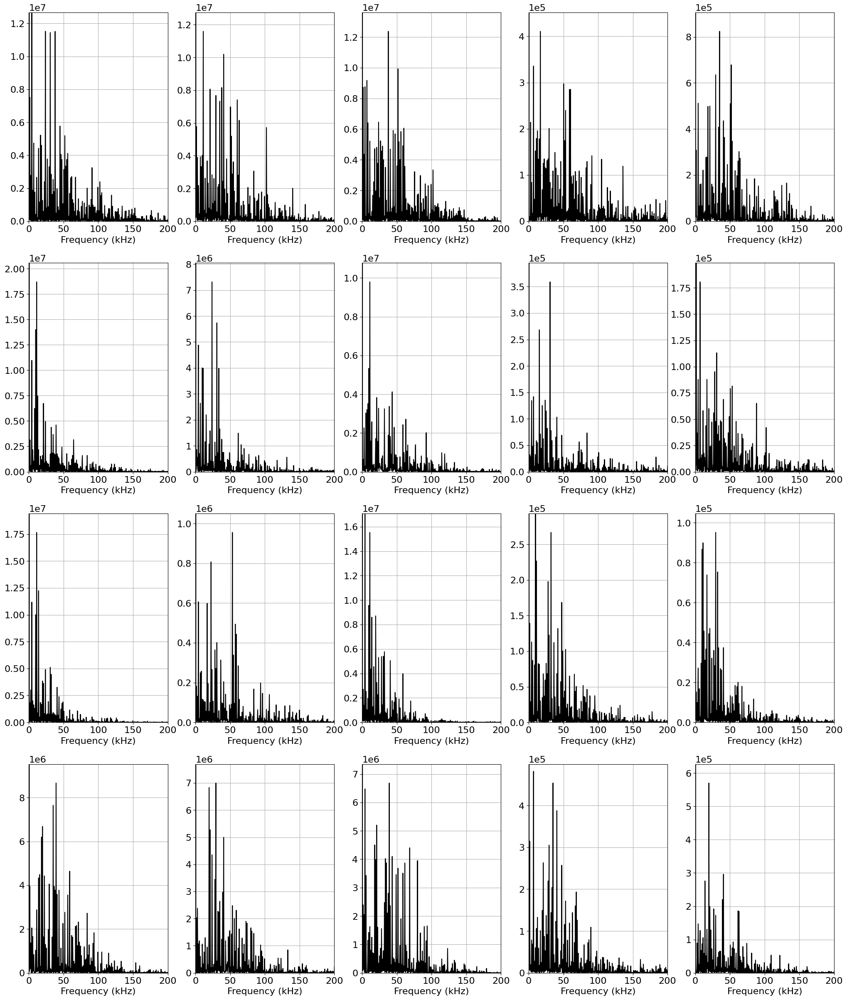

In [ ]:
fft_sonda, power_spectrum = dict(), dict()
plt.figure(figsize=(25,30))
for i in range(1,21):
  print(f'\rSonda {i}/20',end='')
  plt.subplot(4,5,i)
  fft_sonda[i], freqs = welch(df_cut[i], 0.8, 10)
  power_spectrum[i] = pow(abs(fft_sonda[i]), 2)
  plt.plot(freqs, power_spectrum[i],'k-')
  plt.grid()
  plt.xlabel('Frequency (kHz)')
  plt.axis([0,200,0,1.1*sort(power_spectrum[i][where(freqs > 10)])[-3]])
  plt.ticklabel_format(axis='y', style='sci', scilimits=(0,0))
plt.savefig('ffts.png')
plt.show()

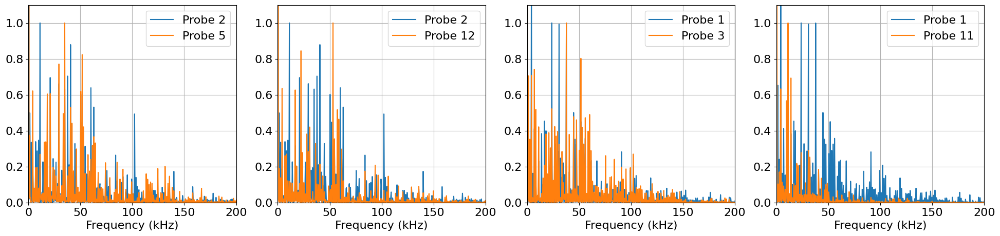

In [ ]:
plots = [[2,5],[2,12],[1,3],[1,11]]
plt.figure(figsize=(24,5))
for kk, plot in enumerate(plots):
  plt.subplot(1,4,kk+1)
  for k, probe in enumerate(plot):
    plt.plot(freqs, power_spectrum[probe]/sort(power_spectrum[probe][where(freqs > 10)])[-3], label = f'Probe {probe}')
  plt.grid()
  plt.axis([0,200,0,1.1])
  plt.xlabel('Frequency (kHz)')
  plt.legend()
plt.savefig('ffts_compared.png')
plt.show()

Sonda 20/20

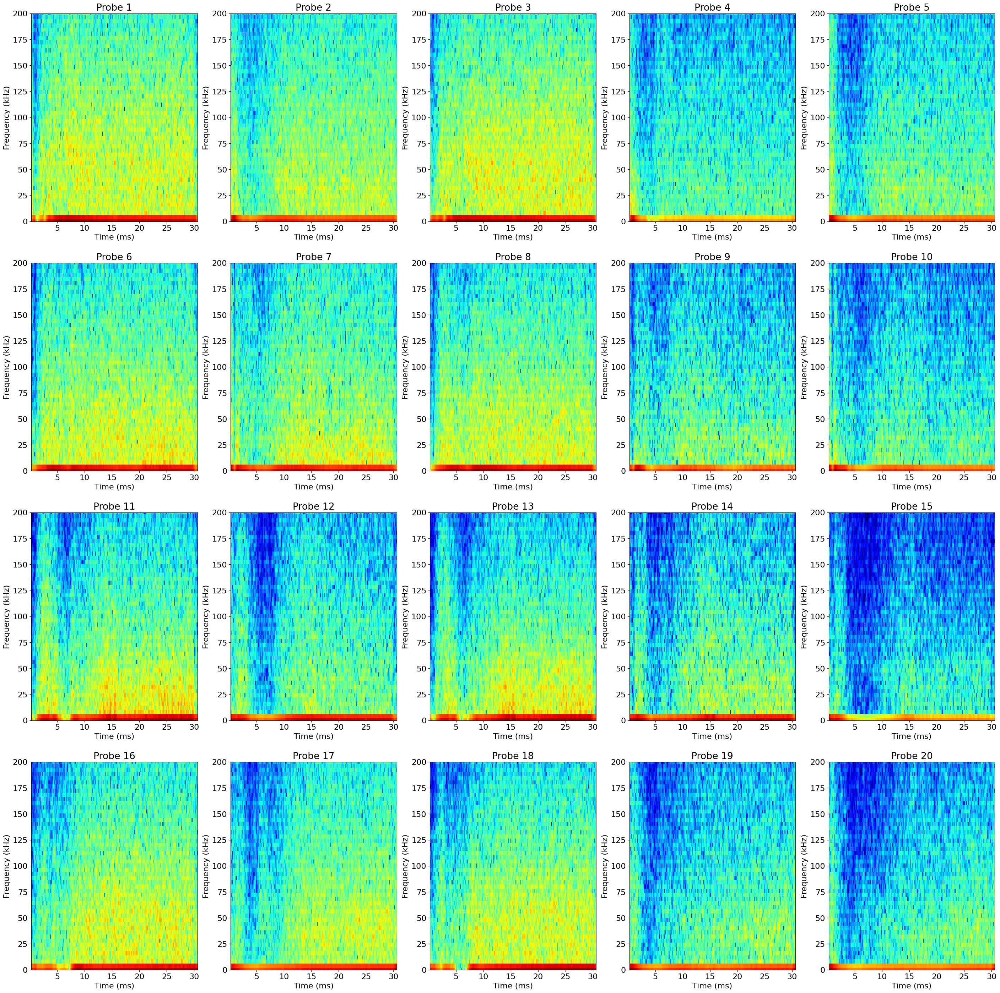

In [ ]:
plt.figure(figsize=(35,35))
for i in range(1,21):
  print(f'\rSonda {i}/20',end='')
  plt.subplot(4,5,i)
  spectras, tempos, freqs = spectrogram(array(df[i]), array(df.index), 500e-6, overlap=0.5, N=3)
  plot_spectrogram(spectras, freqs, tempos, do_log = True, less_than = 1)
  plt.ylabel('Frequency (kHz)')
  plt.title(f'Probe {i}')
  plt.xlabel('Time (ms)')
  plt.ylim([0,200])
plt.savefig('periodograms.png')
plt.show()

In [ ]:
coherences = {i: dict() for i in range(1,21)}
L = len(df_cut[i])
plt.figure(figsize=(100,100))
for i, j in itertools.product(range(1,21),range(1,21)):
  a = 0.6
  N = 30
  l=int(L/(a-a*N+N))
  freqs, coherences[i][j] = coherence(df_cut[i], df_cut[j], fs = 1/delta_t, nperseg = l, noverlap = int(a*l))

  plt.subplot(20,20,20*(i-1)+j)
  plt.plot(freqs, coherences[i][j],'k-')
  if i != j:
    plt.axis([0,1e6,0,1])
  else:
    plt.xlim([0,1e6])
  plt.grid()
  plt.legend([f'Probes {i} and {j}'], loc = 'upper right')
plt.savefig('coherence_plots.png')
plt.show()

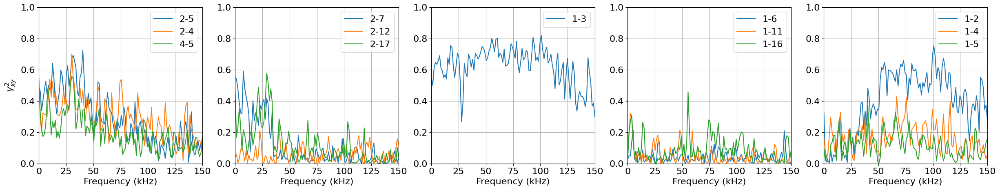

In [ ]:
plots = [[(2,5),(2,4),(4,5)],[(2,7),(2,12),(2,17)],[(1,3)],[(1,6),(1,11),(1,16)],[(1,2),(1,4),(1,5)]]
plt.figure(figsize=(30,5))
for kk, plot in enumerate(plots):
  plt.subplot(1,5,kk+1)
  for k, (i,j) in enumerate(plot):
    plt.plot(freqs/1000, coherences[i][j], label = f'{i}-{j}')
  plt.grid()
  plt.xlabel('Frequency (kHz)')
  plt.legend(loc = 'upper right')
  if kk == 0:
    plt.ylabel('$\gamma_{xy}^2$')
  plt.axis([0,150,0,1])
plt.savefig('coherences_compared.png')
plt.show()

In [ ]:
freqs[freqs>41e3][argmax(coherences[1][5][where((freqs < 150e3)&(freqs > 41e3))])]

65532.45116572149